# DCGAN on CIFAR10

-------------


In [2]:
#!nvidia-smi
!pip install torchsummary

In [3]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision.datasets import ImageFolder
import torchvision.transforms as transforms
import torchvision.transforms.functional as F
from torchvision.utils import make_grid
from torchsummary import summary
from torchvision import datasets

import matplotlib.pyplot as plt
import PIL
import os
import seaborn as sns
import numpy as np
from tqdm.notebook import tqdm
import pickle
import pandas as pd

# Data

In [4]:
plt.rcParams["savefig.bbox"] = 'tight'


def show(imgs):
    if not isinstance(imgs, list):
        imgs = [imgs]
    fix, axs = plt.subplots(figsize=(12,8), ncols=len(imgs), squeeze=False)
    for i, img in enumerate(imgs):
        img = img.detach()
        img = F.to_pil_image(img)
        axs[0, i].imshow(np.asarray(img))
        axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])   
    plt.show()

In [5]:
dataset = datasets.CIFAR10(root='.', download=True, 
                           transform=transforms.Compose([transforms.Resize(size=64),
                                                         transforms.ToTensor()]))
dataloader = DataLoader(dataset=dataset, batch_size=32, 
                        num_workers=0, shuffle=True)

  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting ./cifar-10-python.tar.gz to .


In [6]:
real_batch = next(iter(dataloader))

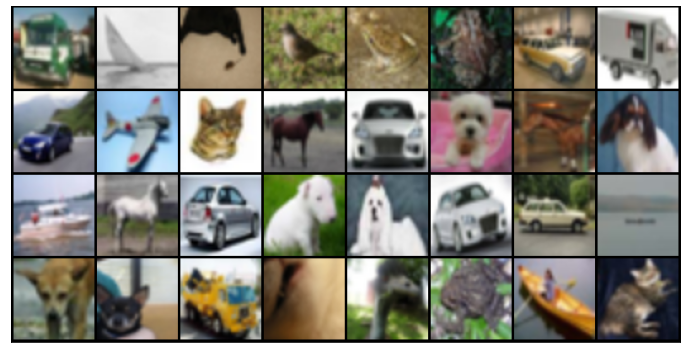

In [7]:
show(make_grid(real_batch[0]))

## Model

In [8]:
# According to Implementation https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
class DCGANDiscriminator(nn.Module):
    def __init__(self):
        super(DCGANDiscriminator, self).__init__()
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(3, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(64, 64 * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(64 * 2, 64 * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(64 * 4, 64 * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(64 * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)
    
# Generator Code

class DCGANGenerator(nn.Module):
    def __init__(self):
        super(DCGANGenerator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( 100, 64 * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(64 * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(64 * 8, 64 * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( 64 * 4, 64 * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( 64 * 2, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( 64, 3, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [9]:
summary(DCGANDiscriminator().to('cuda'), (3, 64, 64))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 32, 32]           3,072
         LeakyReLU-2           [-1, 64, 32, 32]               0
            Conv2d-3          [-1, 128, 16, 16]         131,072
       BatchNorm2d-4          [-1, 128, 16, 16]             256
         LeakyReLU-5          [-1, 128, 16, 16]               0
            Conv2d-6            [-1, 256, 8, 8]         524,288
       BatchNorm2d-7            [-1, 256, 8, 8]             512
         LeakyReLU-8            [-1, 256, 8, 8]               0
            Conv2d-9            [-1, 512, 4, 4]       2,097,152
      BatchNorm2d-10            [-1, 512, 4, 4]           1,024
        LeakyReLU-11            [-1, 512, 4, 4]               0
           Conv2d-12              [-1, 1, 1, 1]           8,192
          Sigmoid-13              [-1, 1, 1, 1]               0
Total params: 2,765,568
Trainable param

In [10]:
summary(DCGANGenerator().to('cuda'), (100, 1, 1))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]         819,200
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 256, 8, 8]       2,097,152
       BatchNorm2d-5            [-1, 256, 8, 8]             512
              ReLU-6            [-1, 256, 8, 8]               0
   ConvTranspose2d-7          [-1, 128, 16, 16]         524,288
       BatchNorm2d-8          [-1, 128, 16, 16]             256
              ReLU-9          [-1, 128, 16, 16]               0
  ConvTranspose2d-10           [-1, 64, 32, 32]         131,072
      BatchNorm2d-11           [-1, 64, 32, 32]             128
             ReLU-12           [-1, 64, 32, 32]               0
  ConvTranspose2d-13            [-1, 3, 64, 64]           3,072
             Tanh-14            [-1, 3,

## Dataloader

In [11]:
# Params 
BATCH_SIZE = 32
WORKERS = 2

In [12]:
assert len(real_batch[0]) == BATCH_SIZE, f'{len(real_batch)}, {BATCH_SIZE}'
print('--- Test Passed ---')
del real_batch

--- Test Passed ---


In [13]:
device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")
print(device)

cuda:0


# DCGAN - Deep Convolutional Generative Adversial Network


In [14]:
z_vec = torch.rand(BATCH_SIZE,100,1,1)
print('Z-Vector:', z_vec.shape)

Z-Vector: torch.Size([32, 100, 1, 1])


torch.Size([32, 3, 64, 64])
--- Test Passed ---


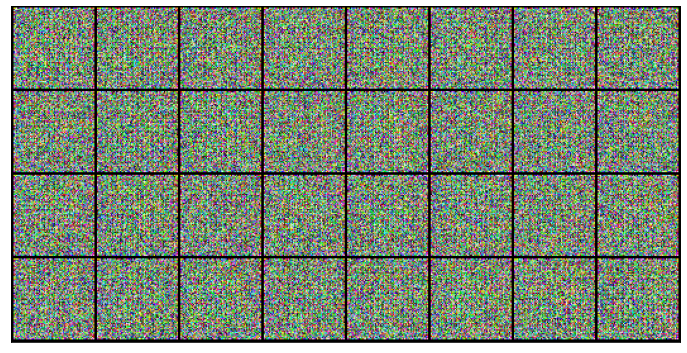

In [15]:
# Test Generator
generator = DCGANGenerator()
out = generator(z_vec)
print(out.shape)
assert out.shape == torch.Size([BATCH_SIZE, 3, 64, 64])
print('--- Test Passed ---')
show(make_grid(out))

In [16]:
# Test Discrimnator
discriminator = DCGANDiscriminator()
sample_image = torch.rand((3, 64, 64))
sample_image = sample_image.unsqueeze(0)

out = discriminator(sample_image)
print(out.shape)
assert out.shape == torch.Size([1, 1, 1, 1])
print('--- Test Passed ---')

torch.Size([1, 1, 1, 1])
--- Test Passed ---


## Model Training

In [17]:
def train_network(generator, discriminator, criterion, 
                  optimizer_generator, optimizer_discriminator, 
                  n_epochs, dataloader, z_dim, 
                  epsilon=None, debug_run=False, show_images=True, **kwargs):
    """
    Trains GAN by using batch-wise fake and real data inputs.
    
    params:
    --------------------
    generator: torch.Network
        Generator model to sample image from latent space.
        
    discriminator: torch.Network
        Discrimantor Model to classify into real or fake.
        
    criterion: 
        Cost-Function used for the network optimizatio
        
    optimizer: torch.Optimizer
        Optmizer for the network
        
    n_epochs: int
        Defines how many times the whole dateset should be fed through the network
        
    dataloader: torch.Dataloader 
        Dataloader with the batched dataset of real data.
        
    epsilon: float
        Stopping Criterion regarding to change in cost-function between two epochs.
        
    debug_run:
        If true than only one batch will be put through network.
        
    returns:
    ---------------------
    generator:
        Trained Torch Generator Model
        
    discriminator:
        Trained Torch Discriminator Model
        
    losses: dict
        dictionary of losses of all batches and Epochs.
        
    """
    print(20*'=', 'Start Training', 20*'=')
    # Init lists to keep track of loss
    training_loss_generator, training_loss_discriminator = [], []
    batch_loss = {'Dreal':[], 'Dfake':[], 'Gfake':[]}
    accuracy = {'real':[], 'fake':[], 'Gfake':[]}
    # Accuracy func
    calculate_accuracy = lambda y_true, y_pred: np.sum(y_true == y_pred) / y_true.shape[0]
    
    # Fixed noise for generating samples
    fixed_noise_dim = kwargs.get('fixed_noise_dim') if kwargs.get('fixed_noise_dim') else dataloader.batch_size
    fixed_noise = torch.randn(fixed_noise_dim, z_dim, 1, 1, device=device)
    
    dev = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
    generator.to(dev), discriminator.to(dev)
    criterion.to(dev)

    generator.train(), discriminator.train()
    overall_length = len(dataloader)
    with tqdm(total=n_epochs*overall_length, disable=debug_run) as pbar:
        for epoch in range(n_epochs):  # loop over the dataset multiple times
            discriminator_running_loss, generator_running_loss = 0.0, 0.0
            for i, data in enumerate(dataloader): 
                
                # Get Batch of real images and pass to Discriminator which first trains on only real data.
                real_images = data[0].to(dev)
                
                # Create Labels
                real_labels = torch.full(size=(real_images.shape[0], ), fill_value=real_label, 
                                         dtype=torch.float, device=device)
                fake_labels = torch.full(size=(real_images.shape[0], ), fill_value=fake_label, 
                                         dtype=torch.float, device=device)
                flipped_fake_labels = torch.full(size=(real_images.shape[0], ), fill_value=real_label, 
                                                 dtype=torch.float, device=device)    
                
                # Create noise from normal distribution
                # Generate Batch of latent vectors
                noise_vec = torch.randn(real_images.shape[0], Z_DIM, 1, 1, device=device)                
                
                # -----------------------------------------
                # REAL IMAGES - Training Discriminator 
                # -----------------------------------------
                discriminator.zero_grad()
                
                # Pass into Discriminator
                out = discriminator(real_images).view(-1)
                loss_real = criterion(out, real_labels)
                loss_real.backward()
                
                batch_loss['Dreal'].append(loss_real.mean().item())
                pred = torch.round(out)
                accuracy['real'].append(calculate_accuracy(real_labels.cpu().numpy(), 
                                                           pred.detach().cpu().numpy()))  
                 
                # -----------------------------------------
                # Fake Images - Discriminator
                # -----------------------------------------
                
                # Pass noise to generator
                fake_images = generator(noise_vec)
                # Passed generated images to discriminator
                out = discriminator(fake_images.detach()).view(-1)
                
                # Calculate Loss on Fake images
                loss_fake = criterion(out, fake_labels)
                loss_fake.backward()
                
                d_loss = loss_real + loss_fake
                
                # Udpate Discriminator Optimizer
                optimizer_discriminator.step()
                
                batch_loss['Dfake'].append(loss_fake.mean().item())
                
                # Calculate overall loss over both and append
                discriminator_running_loss += d_loss.mean().item()
                
                # Calculate accuracy on real images 
                pred = torch.round(out)
                accuracy['fake'].append(calculate_accuracy(fake_labels.cpu().numpy(), 
                                                           pred.detach().cpu().numpy()))
                # -----------------------------------------
                # FAKE - Training of Generator 
                # -----------------------------------------
                generator.zero_grad()
                                
                #fake_images = generator(G_z_vec)
                out = discriminator(fake_images).view(-1)
                loss_generator = criterion(out, flipped_fake_labels)
                loss_generator.backward()
                
                # Update G
                optimizer_generator.step()
                
                # Append Losses 
                batch_loss['Gfake'].append(loss_generator.mean().item())
                pred = torch.round(out)
                accuracy['Gfake'].append(calculate_accuracy(1-flipped_fake_labels.cpu().numpy(), 
                                                            pred.detach().cpu().numpy()))
                generator_running_loss += loss_generator.mean().item()
                
                # ----------------------------------------
                # calc and print stats
                pbar.set_description(f'Epoch: {epoch+1}/{n_epochs} // GRL: {round(generator_running_loss, 3)}  -- '+
                                     f'DRL: {round(discriminator_running_loss, 3)} ')
                pbar.update(1)
                if debug_run:
                    print('- Training Iteration passed. -')
                    break
                
            print(f'Epoch {epoch+1} // [GRL: {np.round(generator_running_loss, 3)}]  -- '+
                  f'[DRL: {np.round(discriminator_running_loss, 3)}] -- ' + 
                  f'[Accuracy (R/F): {round(np.mean(accuracy["real"][:-i]), 3)} - ',
                  f'{round(np.mean(accuracy["fake"][:-i]), 3)}]')
            
            training_loss_generator.append(generator_running_loss)
            training_loss_discriminator.append(discriminator_running_loss)
            
            if show_images:
                with torch.no_grad():
                    imgs = generator(fixed_noise).detach().cpu()
                    show(make_grid(imgs))
                    
            
            if epsilon:
                if epoch > 0:
                    diff = np.abs(training_loss_generator[-2] - generator_running_loss)
                    if diff < epsilon:
                        print('- Network Converged. Stopped Training. -')
                        break

            if debug_run:
                # Breaks loop 
                break
        
    print(20*'=', 'Finished Training', 20*'=')
    return generator, discriminator, dict(generator=training_loss_generator,
                                          discriminator=training_loss_discriminator,
                                          batch_loss=batch_loss, accuracy=accuracy)

In [18]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0)

In [29]:
discriminator = DCGANDiscriminator()
discriminator.apply(weights_init)

generator = DCGANGenerator()
generator.apply(weights_init)

DCGANGenerator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
 

In [31]:
torch.cuda.empty_cache()

####################################################
# Training Parameters
Z_DIM = 100
N_EPOCHS = 100
DEBUG_RUN = False
WORKERS = 0 
BATCH_SIZE = 256 
####################################################

dataset = datasets.CIFAR10(root='.', download=True, 
                           transform=transforms.Compose([transforms.Resize(size=64),
                                                         transforms.ToTensor()]))
dataloader = DataLoader(dataset=dataset, batch_size=BATCH_SIZE, 
                        num_workers=WORKERS, shuffle=True)

# Defines label to train on 
real_label = 1.
fake_label = 0.

criterion = nn.BCELoss()
optimizer_generator = optim.Adam(generator.parameters(), lr=.0005, betas=(.5, .999))
optimizer_discriminator = optim.Adam(discriminator.parameters(), lr=.0005, betas=(.5, .999))

Files already downloaded and verified


==================== Start Training ====================


  0%|          | 0/19600 [00:00<?, ?it/s]

Epoch 1 // [GRL: 1775.414]  -- [DRL: 239.525] -- [Accuracy (R/F): 0.648 -  0.289]


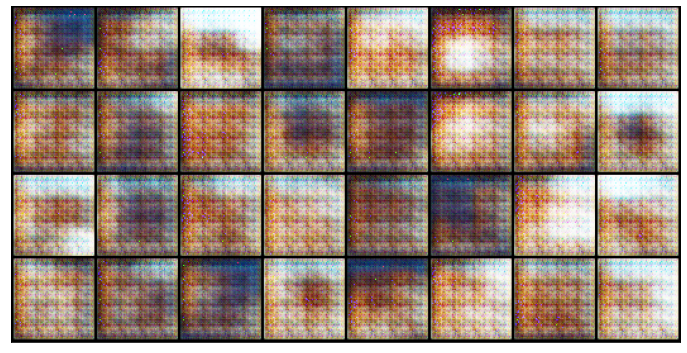

Epoch 2 // [GRL: 506.966]  -- [DRL: 213.433] -- [Accuracy (R/F): 0.789 -  0.783]


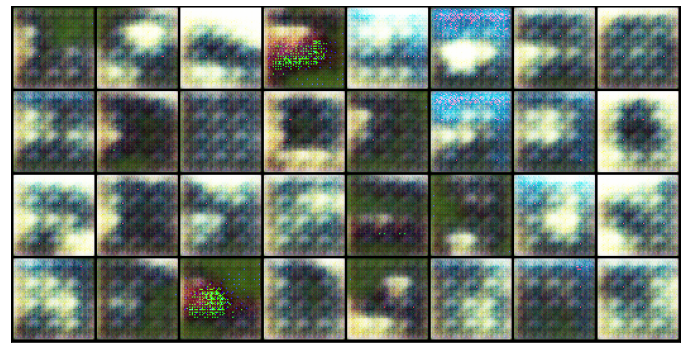

Epoch 3 // [GRL: 466.683]  -- [DRL: 212.903] -- [Accuracy (R/F): 0.761 -  0.763]


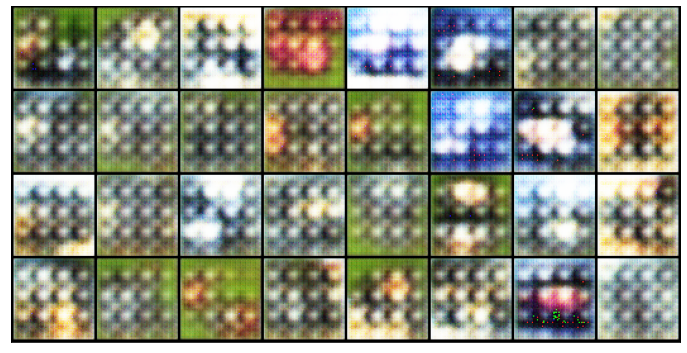

Epoch 4 // [GRL: 428.744]  -- [DRL: 207.613] -- [Accuracy (R/F): 0.755 -  0.758]


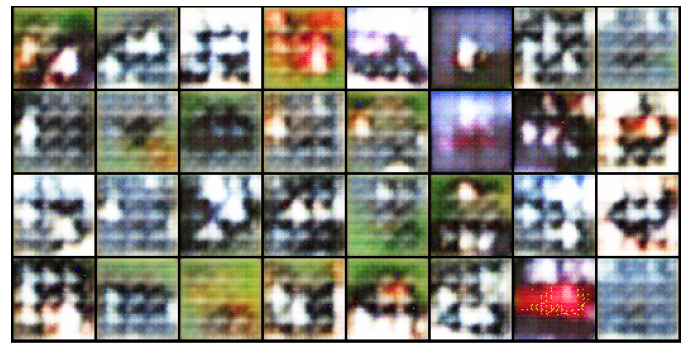

Epoch 5 // [GRL: 394.517]  -- [DRL: 218.208] -- [Accuracy (R/F): 0.752 -  0.757]


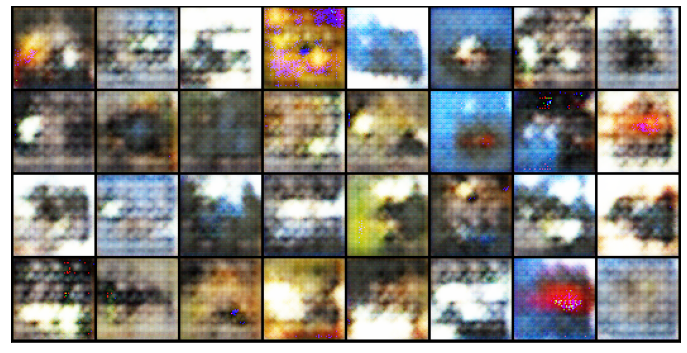

Epoch 6 // [GRL: 346.181]  -- [DRL: 226.451] -- [Accuracy (R/F): 0.745 -  0.75]


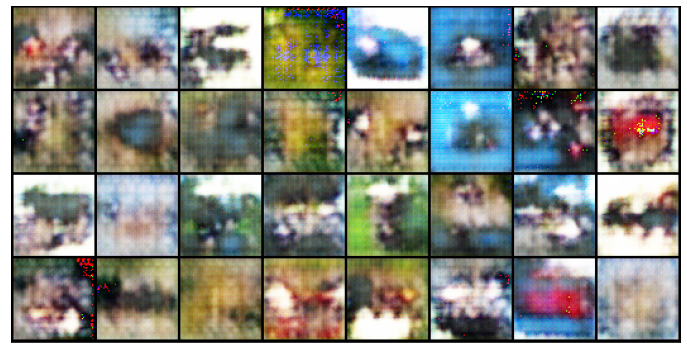

Epoch 7 // [GRL: 325.552]  -- [DRL: 226.772] -- [Accuracy (R/F): 0.737 -  0.743]


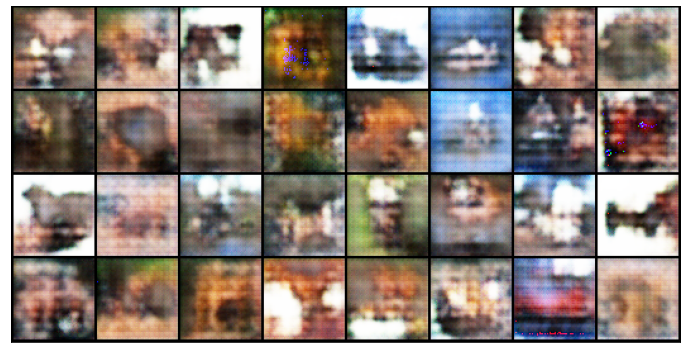

Epoch 8 // [GRL: 357.14]  -- [DRL: 222.27] -- [Accuracy (R/F): 0.731 -  0.738]


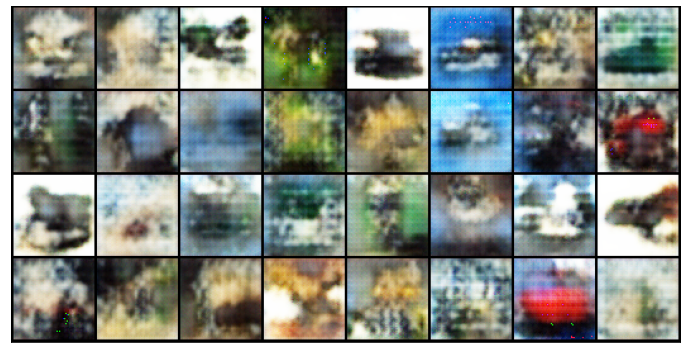

Epoch 9 // [GRL: 343.407]  -- [DRL: 217.472] -- [Accuracy (R/F): 0.728 -  0.734]


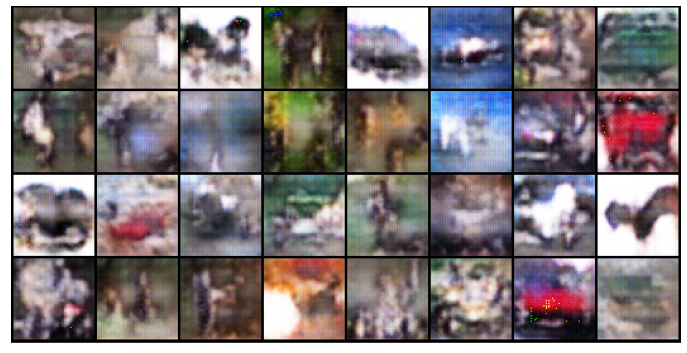

Epoch 10 // [GRL: 348.187]  -- [DRL: 222.797] -- [Accuracy (R/F): 0.727 -  0.732]


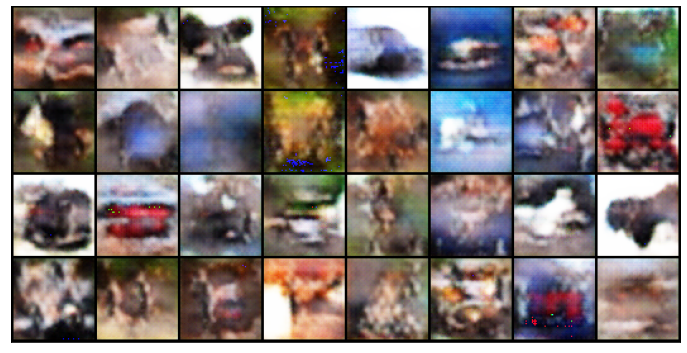

Epoch 11 // [GRL: 369.18]  -- [DRL: 218.953] -- [Accuracy (R/F): 0.724 -  0.73]


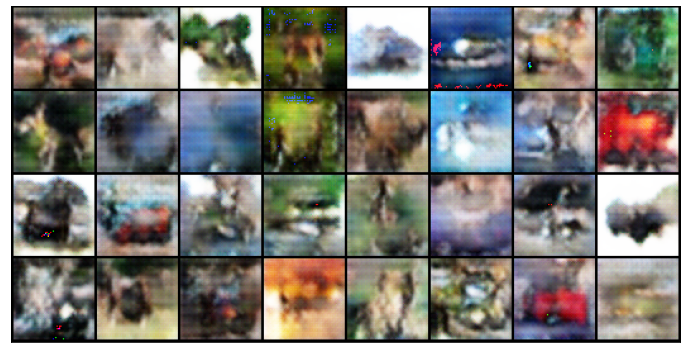

Epoch 12 // [GRL: 401.404]  -- [DRL: 216.384] -- [Accuracy (R/F): 0.723 -  0.729]


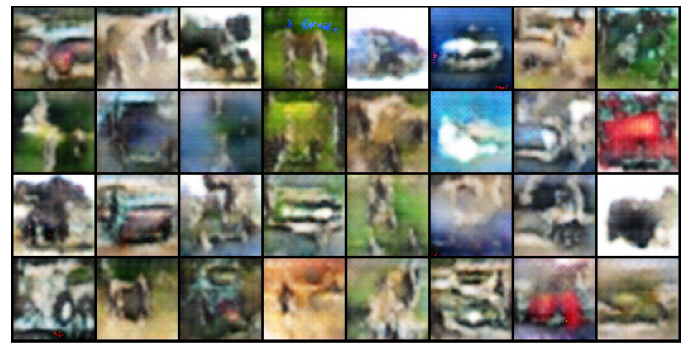

Epoch 13 // [GRL: 402.671]  -- [DRL: 209.923] -- [Accuracy (R/F): 0.723 -  0.728]


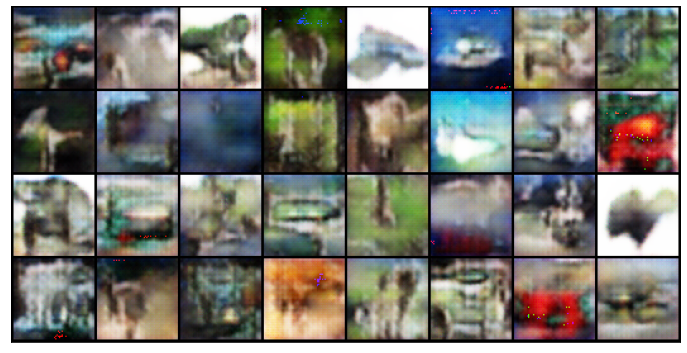

Epoch 14 // [GRL: 460.675]  -- [DRL: 198.335] -- [Accuracy (R/F): 0.725 -  0.729]


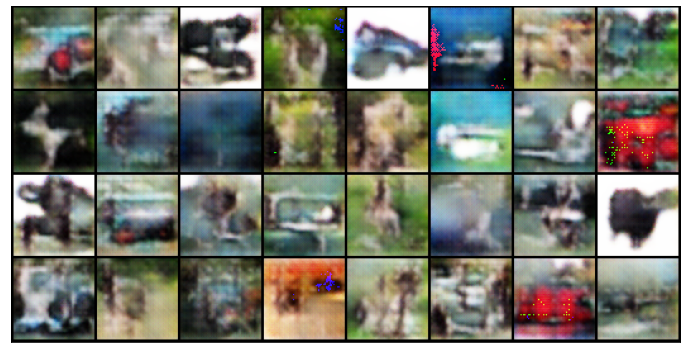

Epoch 15 // [GRL: 466.42]  -- [DRL: 183.607] -- [Accuracy (R/F): 0.727 -  0.732]


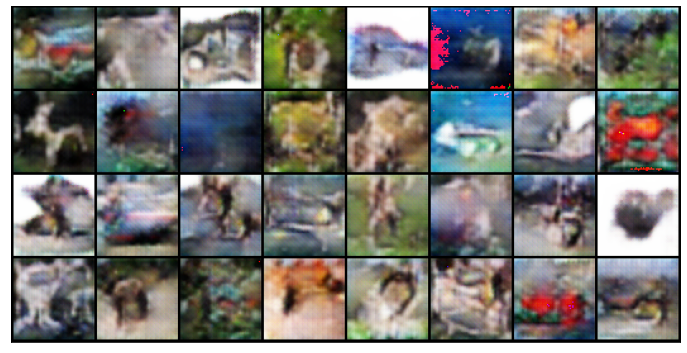

Epoch 16 // [GRL: 479.28]  -- [DRL: 186.655] -- [Accuracy (R/F): 0.731 -  0.737]


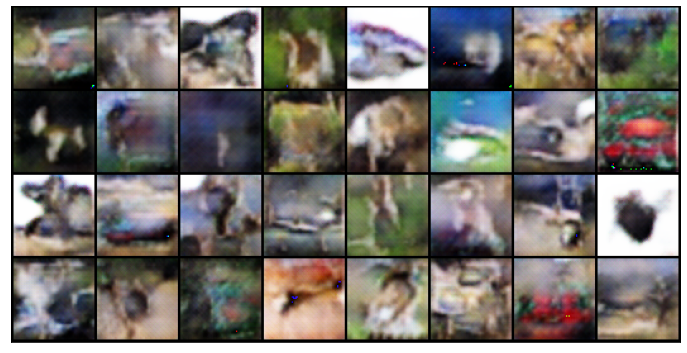

Epoch 17 // [GRL: 588.399]  -- [DRL: 160.9] -- [Accuracy (R/F): 0.734 -  0.741]


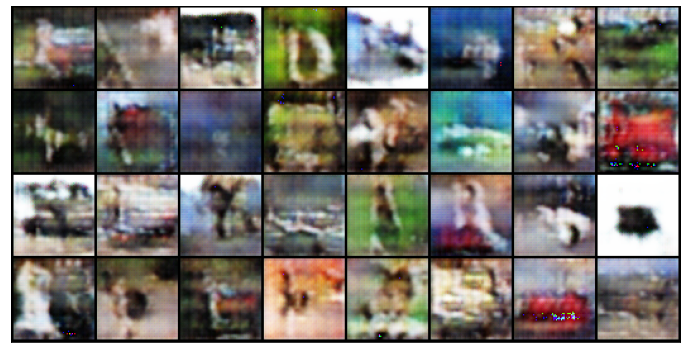

Epoch 18 // [GRL: 326.409]  -- [DRL: 213.53] -- [Accuracy (R/F): 0.739 -  0.745]


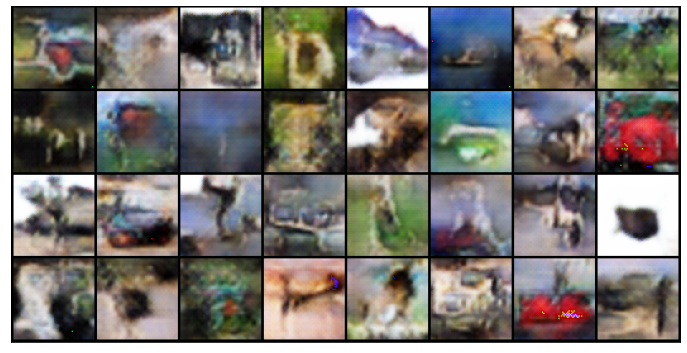

Epoch 19 // [GRL: 395.942]  -- [DRL: 200.191] -- [Accuracy (R/F): 0.739 -  0.745]


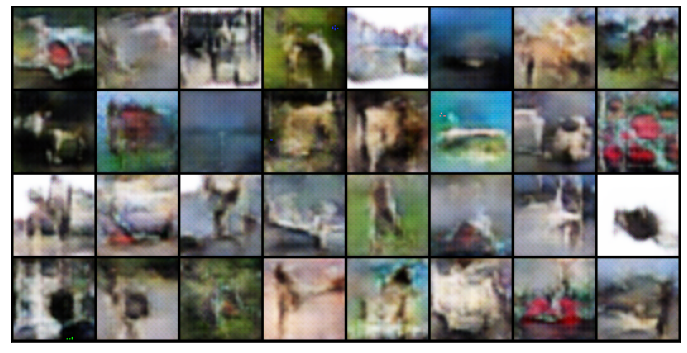

Epoch 20 // [GRL: 438.047]  -- [DRL: 195.58] -- [Accuracy (R/F): 0.74 -  0.746]


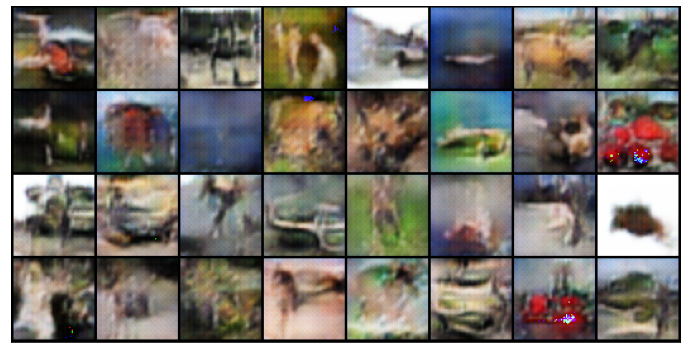

Epoch 21 // [GRL: 431.41]  -- [DRL: 196.097] -- [Accuracy (R/F): 0.742 -  0.748]


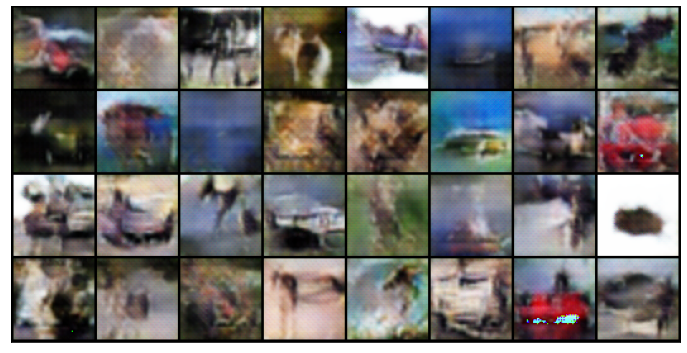

Epoch 22 // [GRL: 517.964]  -- [DRL: 179.082] -- [Accuracy (R/F): 0.744 -  0.749]


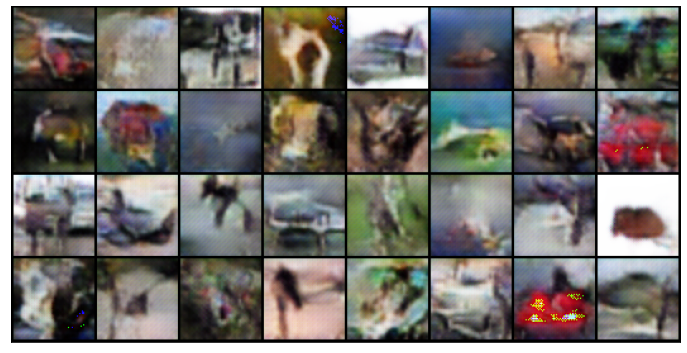

Epoch 23 // [GRL: 547.743]  -- [DRL: 147.577] -- [Accuracy (R/F): 0.746 -  0.752]


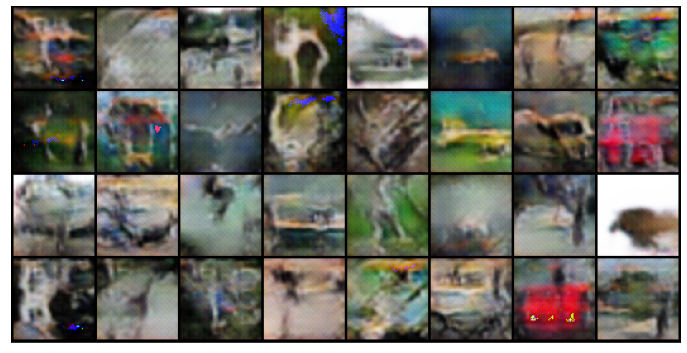

Epoch 24 // [GRL: 916.464]  -- [DRL: 89.647] -- [Accuracy (R/F): 0.751 -  0.757]


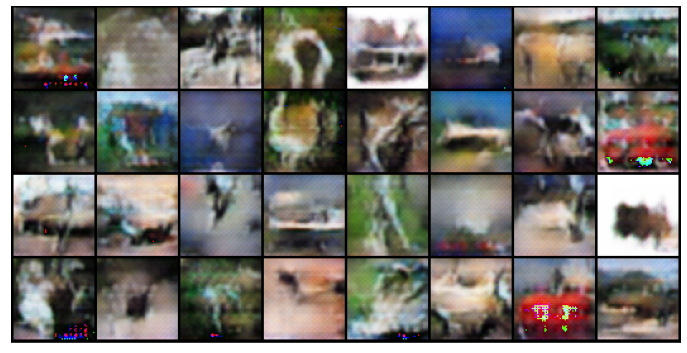

Epoch 25 // [GRL: 475.616]  -- [DRL: 181.515] -- [Accuracy (R/F): 0.757 -  0.763]


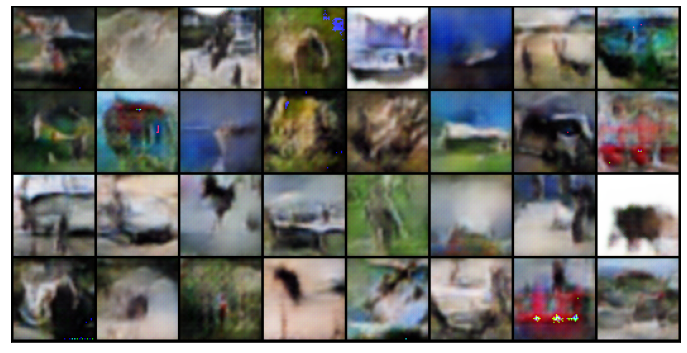

Epoch 26 // [GRL: 458.555]  -- [DRL: 180.11] -- [Accuracy (R/F): 0.759 -  0.765]


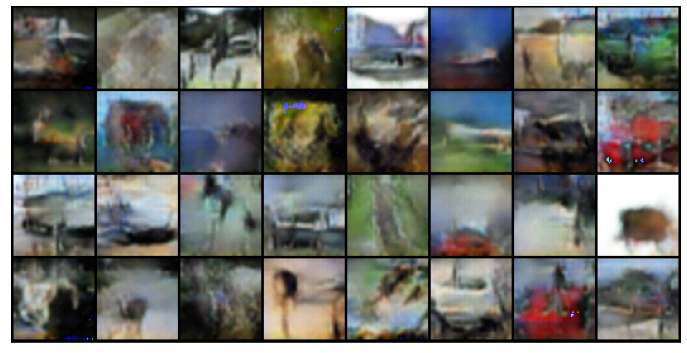

Epoch 27 // [GRL: 481.261]  -- [DRL: 177.606] -- [Accuracy (R/F): 0.76 -  0.766]


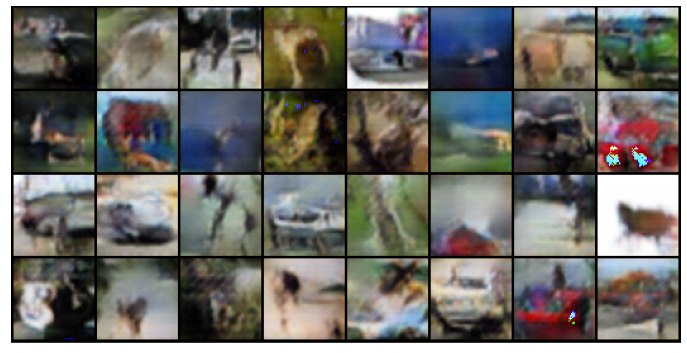

Epoch 28 // [GRL: 472.914]  -- [DRL: 177.3] -- [Accuracy (R/F): 0.762 -  0.768]


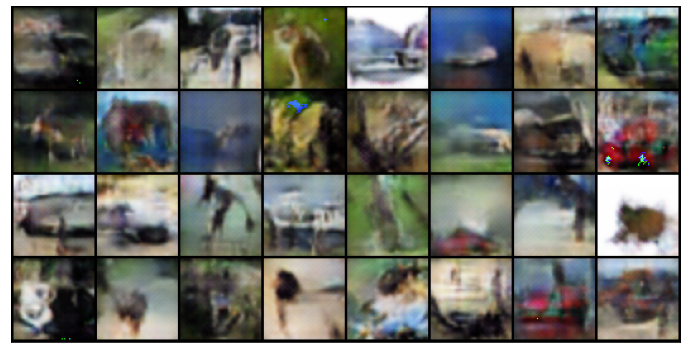

Epoch 29 // [GRL: 550.949]  -- [DRL: 148.297] -- [Accuracy (R/F): 0.763 -  0.77]


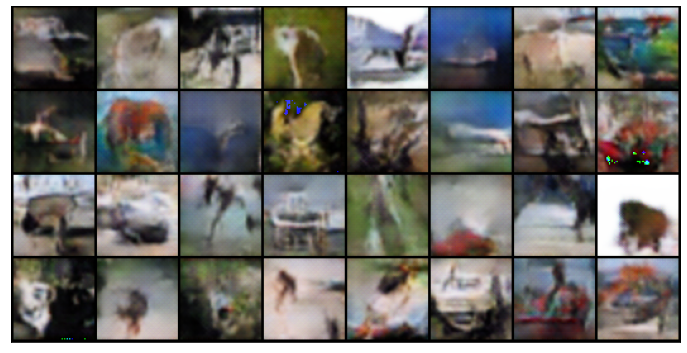

Epoch 30 // [GRL: 697.234]  -- [DRL: 116.579] -- [Accuracy (R/F): 0.766 -  0.772]


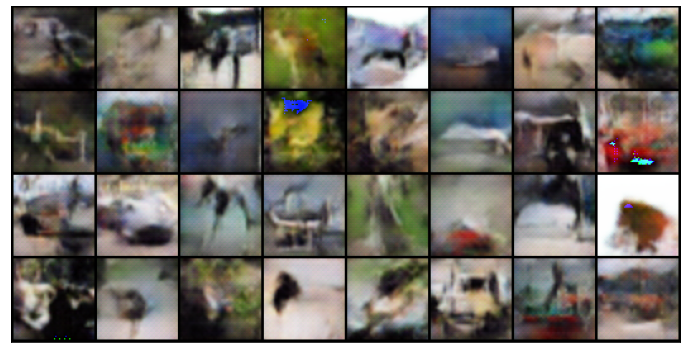

Epoch 31 // [GRL: 501.07]  -- [DRL: 172.639] -- [Accuracy (R/F): 0.77 -  0.777]


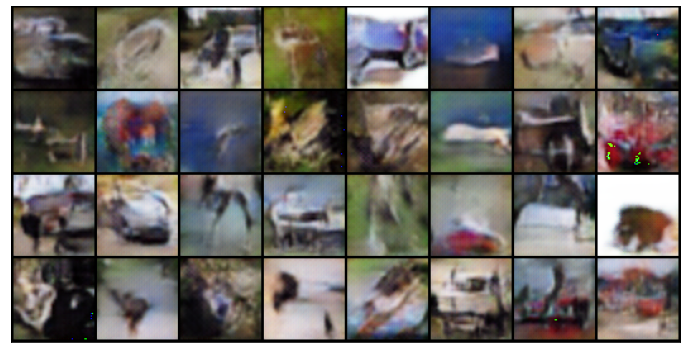

Epoch 32 // [GRL: 445.854]  -- [DRL: 180.021] -- [Accuracy (R/F): 0.772 -  0.778]


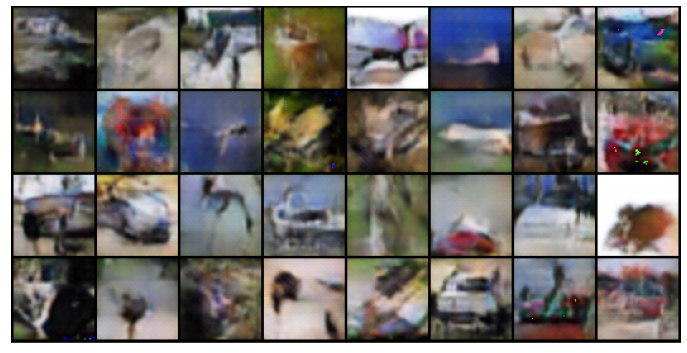

Epoch 33 // [GRL: 471.678]  -- [DRL: 166.689] -- [Accuracy (R/F): 0.773 -  0.779]


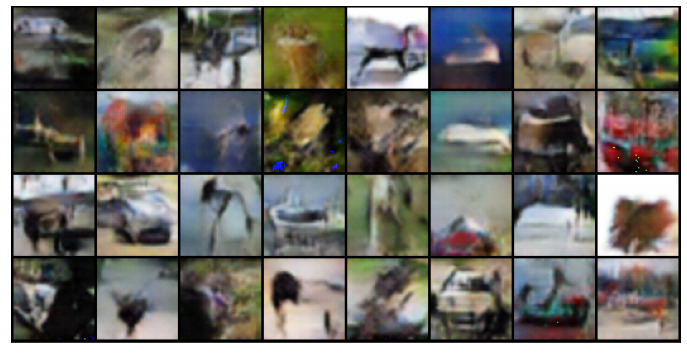

Epoch 34 // [GRL: 490.451]  -- [DRL: 170.027] -- [Accuracy (R/F): 0.774 -  0.781]


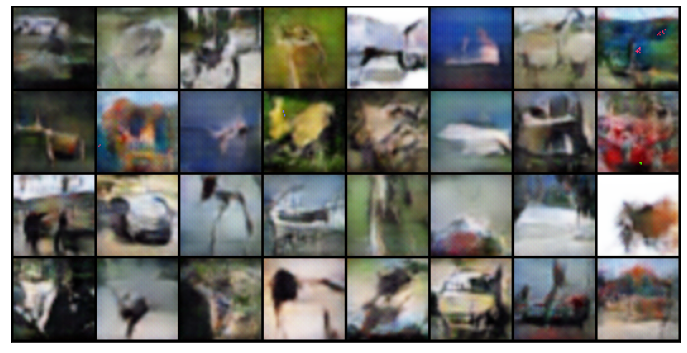

Epoch 35 // [GRL: 499.099]  -- [DRL: 155.098] -- [Accuracy (R/F): 0.776 -  0.782]


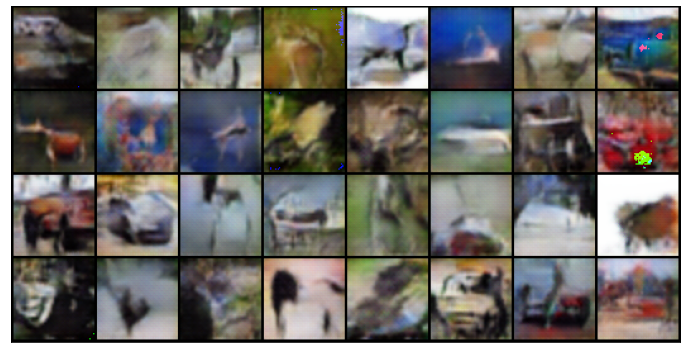

Epoch 36 // [GRL: 626.934]  -- [DRL: 132.327] -- [Accuracy (R/F): 0.777 -  0.784]


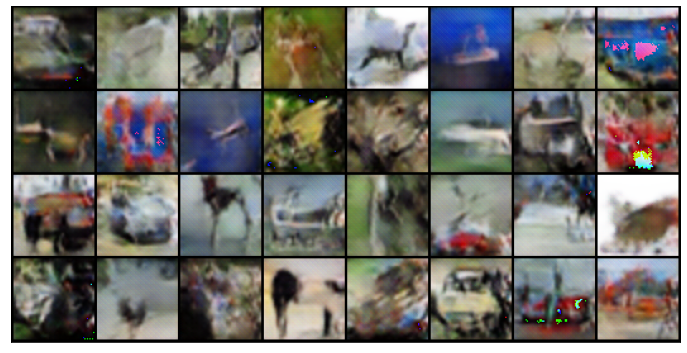

Epoch 37 // [GRL: 479.821]  -- [DRL: 179.991] -- [Accuracy (R/F): 0.78 -  0.786]


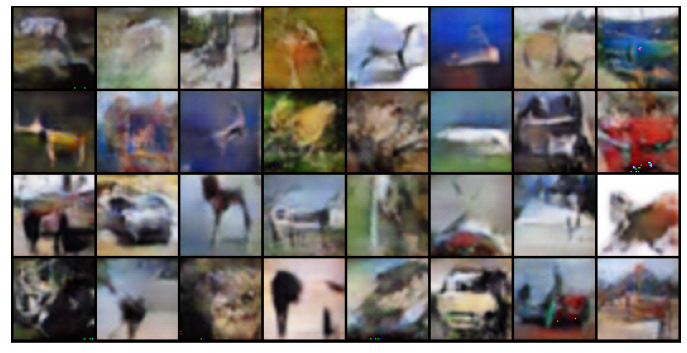

Epoch 38 // [GRL: 571.31]  -- [DRL: 143.283] -- [Accuracy (R/F): 0.781 -  0.787]


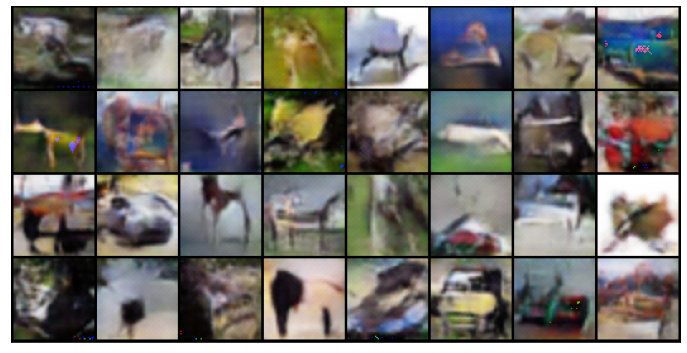

Epoch 39 // [GRL: 456.896]  -- [DRL: 154.543] -- [Accuracy (R/F): 0.782 -  0.789]


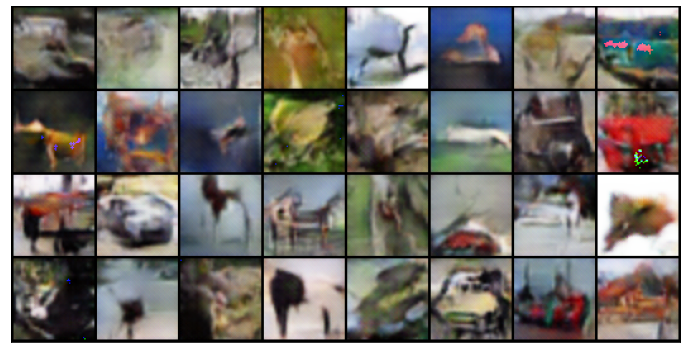

In [ ]:
generator, discriminator, loss = train_network(generator=generator, discriminator=discriminator, 
                                               criterion=criterion, optimizer_generator=optimizer_generator, 
                                               optimizer_discriminator=optimizer_discriminator, z_dim=Z_DIM,
                                               n_epochs=N_EPOCHS, dataloader=dataloader, debug_run=DEBUG_RUN,
                                               fixed_noise_dim=32)

In [ ]:
def plot_batch_loss(loss: dict):
    tmp = pd.DataFrame.from_dict(loss['batch_loss']) \
        .reset_index() \
        .melt(id_vars='index', value_name='loss', var_name='type')
    
    fig = plt.subplots(figsize=(8, 4))
    p = sns.lineplot(x=tmp['index'], y=tmp['loss'], style=tmp['type'], 
                     hue=tmp['type'], palette='Paired')
    p.set_title('Batch Loss', loc='left')
    p.set_xlabel('Batch')
    p.set_ylabel('BCE-Loss')
    sns.despine()
    plt.show()
    
def plot_batch_acc(loss: dict):
    tmp = pd.DataFrame.from_dict(loss['accuracy']) \
        .reset_index() \
        .melt(id_vars='index', value_name='acc', var_name='type')
    
    fig = plt.subplots(figsize=(8, 4))
    p = sns.lineplot(x=tmp['index'], y=tmp['acc'], style=tmp['type'], 
                     hue=tmp['type'], palette='Paired')
    p.set_title('Batch Accuracy', loc='left')
    p.set_xlabel('Batch')
    p.set_ylabel('Accuracy')
    sns.despine()
    plt.show()

In [ ]:
plot_batch_loss(loss)

In [ ]:
plot_batch_acc(loss)

In [ ]:
# Save states
SAVE_OUTPUT = False

if SAVE_OUTPUT:
    with open('./models/losses_s128_12eps.pkl', 'wb') as pkl_file:
        pickle.dump(loss, pkl_file)
    
    torch.save(generator, './models/generator_12eps_s128')
    torch.save(discriminator, './models/discriminator_12eps_s128')

In [ ]:
def plot_image_batch(Z):
    """"""
    ncols = 6
    nrows = Z.shape[0] // ncols + 1
    
    with torch.no_grad():
        image_batch = generator(Z)
    
    inverse_transforms = transforms.Compose([transforms.Normalize(mean=(0, 0, 0), std=(1/0.5, 1/0.5, 1/0.5)),
                                             transforms.Normalize(mean=(-.5, -.5, -.5), std=(1, 1, 1)),
                                             transforms.ToPILImage()])     
    fig = plt.subplots(figsize=(16, nrows*3))
    
    for i, image in enumerate(image_batch):
        plt.subplot(nrows, ncols, i+1)
        plt.imshow(inverse_transforms(image))
        plt.axis('off')
    plt.show()

In [ ]:
plot_image_batch(Z=loss['generated_images'][-1])

## Generate Images

generator = torch.load('./models/generator_12eps')

In [ ]:
with torch.no_grad():
    out = generator(torch.randn(1, Z_DIM, 1, 1, device=device))
    
inverse_transforms = transforms.Compose([transforms.ToPILImage()]) 
image = inverse_transforms(out[0].to('cpu'))
plt.imshow(image)

In [ ]:
out[0].shape

torch.save(discriminator, 'discriminator_4eps')

# Sources

https://paperswithcode.com/dataset/lhq

https://universome.github.io/alis

https://arxiv.org/pdf/1511.06434.pdf

https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

https://pytorch.org/docs/stable/generated/torch.nn.ConvTranspose2d.html

https://github.com/soumith/ganhacks